# Analyzing NBA Game Statistics Analysis

Brayden Stach, Julian Loutzenhiser, Katherine Nunn

---

# Main research Question:
Which game statistics have the most impact on the outcome of any given NBA game?

## Project Outline
#### Step 1: Load the Data
- Load the data using the pandas csv reader
- Examine the data to gain a better understanding of what information it holds and how we might use it

#### Step 2: Transform the Data
- Drop unwanted featrues
- Reorganzie the data so each row contains only one team's data
- Examine the cleaned data once more

#### Step 3: Understand the Data
- Use correlation heatmap to see how attributes relate to eachother
- Perform k-means clustering to farther analyze attribute relatedness
    - Choose which columns to include
    - Use Elbow Method and Silhouette Method to determine optimal number of clusters
    - plot clusters and analyze results

#### Step 4: Predict Game Outcome Using Game Data
- Using logistical regression analysis, train an AI aodel to predict W/L based on given game stats





---

# Step 1: Load the Data

## Imports

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [2]:
# Load the data
gamedata = pd.read_csv('game.csv')

In [3]:
gamedata.describe()

,season_id,team_id_home,game_id,min,fgm_home,fga_home,fg_pct_home,fg3m_home,fg3a_home,fg3_pct_home,...,dreb_away,reb_away,ast_away,stl_away,blk_away,tov_away,pf_away,pts_away,plus_minus_away,video_available_away
count,65698.000000,6.569800e+04,6.569800e+04,65698.000000,65685.000000,50251.000000,50208.000000,52480.000000,47015.000000,46624.000000,...,46700.000000,49973.000000,49897.000000,46849.000000,47073.000000,47013.000000,62847.000000,65698.000000,65698.000000,65698.000000
mean,22949.338747,1.609926e+09,2.584747e+07,221.003486,39.672269,83.992796,0.467321,5.735099,17.741146,0.346136,...,30.238073,42.119645,22.135419,7.854148,4.681537,15.199860,23.097284,100.991567,-3.627569,0.201330
std,5000.305500,3.324313e+07,6.303760e+06,67.903521,6.770802,9.164445,0.059423,4.537337,10.545810,0.151234,...,5.588675,6.867396,5.380805,3.031766,2.500820,4.299798,5.227208,14.418755,13.091395,0.400997
min,12005.000000,4.500000e+01,1.050000e+07,0.000000,4.000000,0.000000,0.140000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,19.000000,-73.000000,0.000000
25%,21981.000000,1.610613e+09,2.130053e+07,240.000000,35.000000,78.000000,0.427000,2.000000,10.000000,0.261000,...,26.000000,37.000000,18.000000,6.000000,3.000000,12.000000,20.000000,92.000000,-12.000000,0.000000
50%,21997.000000,1.610613e+09,2.630007e+07,240.000000,40.000000,84.000000,0.467000,5.000000,16.000000,0.348000,...,30.000000,42.000000,22.000000,8.000000,4.000000,15.000000,23.000000,101.000000,-4.000000,0.000000
75%,22011.000000,1.610613e+09,2.880069e+07,240.000000,44.000000,89.000000,0.506000,9.000000,24.000000,0.429750,...,34.000000,47.000000,26.000000,10.000000,6.000000,18.000000,26.000000,110.000000,5.000000,0.000000
max,42022.000000,1.610617e+09,4.980009e+07,365.000000,84.000000,240.000000,0.697000,28.000000,77.000000,1.000000,...,60.000000,90.000000,89.000000,27.000000,19.000000,40.000000,115.000000,196.000000,68.000000,1.000000


Our initial dataset includes data from 65,000+ NBA games played between 1946 and 2023, from the Kaggle NBA Database: https://www.kaggle.com/datasets/wyattowalsh/basketball

## Column contents:
### General Information
- `season_id` (int) Unique identifier for the NBA season.
- `game_id` (int) Unique identifier for the specific game.
- `game_date` (date_time) Date on which the game was played.
- `season_type` (str) Indicates whether the game was in the regular season, playoffs, or preseason.
### Home Team Details
- `team_id_home` (int) Unique identifier for the home team.
- `team_abbreviation_home` (str) Short abbreviation for the home team.
- `team_name_home` (str) Full name of the home team.
- `matchup_home` (str) Shows the matchup details from the home team's perspective (e.g., "LAL vs BOS").
- `wl_home` (char) Win or loss indicator for the home team.
- `video_available_home` (int) Whether video footage is available for this game.
### Away Team Details
- `team_id_away` (int) Unique identifier for the away team.
- `team_abbreviation_away` (str) Short abbreviation for the away team.
- `team_name_away` (str) Full name of the away team.
- `matchup_away` (str) Shows matchup details from the away team's perspective (e.g., "BOS @ LAL").
- `wl_away` (char) Win or loss indicator for the away team.
- `video_available_away` (int) Whether video footage is available for this game.
### Home Team Stats
- `min` (int) Total minutes played by the home team.
- `fgm_home` (int) Field goals made by the home team.
- `fga_home` (int) Field goals attempted by the home team.
- `fg_pct_home` (double) Field goal percentage of the home team.
- `fg3m_home` (int) Three-point field goals made by the home team.
- `fg3a_home` (int) Three-point field goals attempted by the home team.
- `fg3_pct_home` (double) Three-point percentage of the home team.
- `ftm_home` (int) Free throws made by the home team.
- `fta_home` (int) Free throws attempted by the home team.
- `ft_pct_home` (double) Free throw percentage of the home team.
- `oreb_home` (int) Offensive rebounds secured by the home team.
- `dreb_home` (int) Defensive rebounds secured by the home team.
- `reb_home` (int) Total rebounds secured by the home team.
- `ast_home` (int) Assists made by the home team.
- `stl_home` (int) Steals recorded by the home team.
- `blk_home` (int) Blocks recorded by the home team.
- `tov_home` (int) Turnovers committed by the home team.
- `pf_home` (int) Personal fouls committed by the home team.
- `pts_home` (int) Total points scored by the home team.
- `plus_minus_home` (int) Plus/minus impact for the home team.
### Away Team Stats
- `fgm_away` (int) Field goals made by the away team.
- `fga_away` (int) Field goals attempted by the away team.
- `fg_pct_away` (double) Field goal percentage of the away team.
- `fg3m_away` (int) Three-point field goals made by the away team.
- `fg3a_away` (int) Three-point field goals attempted by the away team.
- `fg3_pct_away` (double) Three-point percentage of the away team.
- `ftm_away` (int) Free throws made by the away team.
- `fta_away` (int) Free throws attempted by the away team.
- `ft_pct_away` (double) Free throw percentage of the away team.
- `oreb_away` (int) Offensive rebounds secured by the away team.
- `dreb_away` (int) Defensive rebounds secured by the away team.
- `reb_away` (int) Total rebounds secured by the away team.
- `ast_away` (int) Assists made by the away team.
- `stl_away` (int) Steals recorded by the away team.
- `blk_away` (int) Blocks recorded by the away team.
- `tov_away` (int) Turnovers committed by the away team.
- `pf_away` (int) Personal fouls committed by the away team.
- `pts_away` (int) Total points scored by the away team.
- `plus_minus_away` (int) Plus/minus impact for the away team.

## General Observations
- This dataset comes from a larger database, so it includes a lot of features like season_id, game_id, and video_available_home/away that is not usefull because were only using this one csv.
- Each row has information for both the home and away teams. It will make training a model later much more simple if each row only had data for one team. Later we will transform the data to be this way.
- Many more columns such as team_id_home/away, team_abbreviation_home/away, and matchup_home/away contain non numerical data that will not be useful for helping us answer our reseach question.
- This dataset only inludes data about what happened in a given game, not about players, or advanced stats that are calculated across many games.

---

# Step 2: Transform the Data

## Drop Unwanted Columns

In [4]:
# Drop columns not needed
columns_to_drop = ['season_id', 'game_id', 'team_id_home', 'team_id_away', 'team_abbreviation_home', 'team_abbreviation_away','matchup_home', 'matchup_away', 'video_available_home', 'video_available_away', 'min' ]
gamedata_dropped = gamedata.drop(columns=columns_to_drop)

Right away, we can drop all of the columns we know we wont want to use.

In [5]:
# Check for null values
print(gamedata_dropped.isnull().sum())

team_name_home         0
game_date              0
wl_home                2
fgm_home              13
fga_home           15447
fg_pct_home        15490
fg3m_home          13218
fg3a_home          18683
fg3_pct_home       19074
ftm_home              16
fta_home            3004
ft_pct_home         3009
oreb_home          18936
dreb_home          18999
reb_home           15729
ast_home           15805
stl_home           18849
blk_home           18626
tov_home           18684
pf_home             2856
pts_home               0
plus_minus_home        0
team_name_away         0
wl_away                2
fgm_away              13
fga_away           15447
fg_pct_away        15489
fg3m_away          13218
fg3a_away          18683
fg3_pct_away       18962
ftm_away              13
fta_away            3004
ft_pct_away         3006
oreb_away          18936
dreb_away          18998
reb_away           15725
ast_away           15801
stl_away           18849
blk_away           18625
tov_away           18685


Thats a lot of null..

After taking a look at the csv in excel, it's clear that almost all of these null values come from the games from 1946 to 1985, presumably before they started recording all the stats every game.

In [6]:
# remove rows with NaNs
gamedata_dropped = gamedata_dropped[pd.to_datetime(gamedata_dropped['game_date']) >= pd.Timestamp('1985-04-17')]

In [7]:
gamedata_dropped.describe()

,fgm_home,fga_home,fg_pct_home,fg3m_home,fg3a_home,fg3_pct_home,ftm_home,fta_home,ft_pct_home,oreb_home,...,oreb_away,dreb_away,reb_away,ast_away,stl_away,blk_away,tov_away,pf_away,pts_away,plus_minus_away
count,46580.000000,46580.000000,46580.000000,46580.000000,46580.000000,46290.000000,46580.000000,46580.000000,46578.000000,46580.000000,...,46580.000000,46580.000000,46580.000000,46580.000000,46580.000000,46580.000000,46580.000000,46580.000000,46580.000000,46580.000000
mean,38.906548,83.628188,0.465951,6.385766,17.884994,0.346913,19.660004,25.964942,0.757788,12.094547,...,11.675505,30.239888,41.915393,21.966896,7.844719,4.673680,15.165135,22.287183,100.513160,-3.345341
std,5.937624,8.553420,0.058524,4.394692,10.486755,0.149324,6.766076,8.389711,0.098337,4.425567,...,4.276541,5.588164,6.636203,5.304682,3.024038,2.495226,4.278136,4.891250,13.405462,13.375674
min,12.000000,29.000000,0.234000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,4.000000,0.000000,0.000000,0.000000,0.000000,33.000000,-73.000000
25%,35.000000,78.000000,0.425000,3.000000,10.000000,0.263000,15.000000,20.000000,0.696000,9.000000,...,9.000000,26.000000,37.000000,18.000000,6.000000,3.000000,12.000000,19.000000,91.000000,-12.000000
50%,39.000000,83.000000,0.465000,6.000000,16.000000,0.348000,19.000000,25.000000,0.763000,12.000000,...,11.000000,30.000000,42.000000,22.000000,8.000000,4.000000,15.000000,22.000000,100.000000,-4.000000
75%,43.000000,89.000000,0.506000,9.000000,24.000000,0.432000,24.000000,31.000000,0.826000,15.000000,...,14.000000,34.000000,46.000000,25.000000,10.000000,6.000000,18.000000,25.000000,109.000000,6.000000
max,84.000000,143.000000,0.697000,28.000000,77.000000,1.000000,61.000000,80.000000,1.000000,44.000000,...,40.000000,60.000000,81.000000,52.000000,24.000000,19.000000,40.000000,52.000000,196.000000,68.000000


We still have 46,500+ games to analyze after dropping NaNs.

## Reorganzie the data so each row contains only one team's data

In [8]:
# Copy home team data into dataframe with generic column names
home_df = gamedata_dropped.copy()
home_df['game_date'] = home_df['game_date']
home_df['season_type'] = home_df['season_type']
home_df['team_name'] = home_df['team_name_home']
home_df['wl'] = home_df['wl_home']
home_df['fgm'] = home_df['fgm_home']
home_df['fga'] = home_df['fga_home']
home_df['fg_pct'] = home_df['fg_pct_home']
home_df['fg3m'] = home_df['fg3m_home']
home_df['fg3a'] = home_df['fg3a_home']
home_df['fg3_pct'] = home_df['fg3_pct_home']
home_df['ftm'] = home_df['ftm_home']
home_df['fta'] = home_df['fta_home']
home_df['ft_pct'] = home_df['ft_pct_home']
home_df['oreb'] = home_df['oreb_home']
home_df['dreb'] = home_df['dreb_home']
home_df['reb'] = home_df['reb_home']
home_df['ast'] = home_df['ast_home']
home_df['stl'] = home_df['stl_home']
home_df['blk'] = home_df['blk_home']
home_df['tov'] = home_df['tov_home']
home_df['pf'] = home_df['pf_home']
home_df['pts'] = home_df['pts_home']
home_df['plus_minus'] = home_df['plus_minus_home']

First we copy all the home team data into a new dataframe with generic column names.

In [9]:
# Drop old columns
columns_to_drop_home = [
    "team_name_home", "wl_home", "fgm_home","fga_home",
    "fg_pct_home", "fg3m_home", "fg3a_home", "fg3_pct_home", 
    "ftm_home", "fta_home", "ft_pct_home", "oreb_home", "dreb_home", 
    "reb_home", "ast_home", "stl_home", "blk_home", "tov_home", "pf_home", 
    "pts_home", "plus_minus_home", "team_name_away", "wl_away", 
    "fgm_away", "fga_away", "fg_pct_away", "fg3m_away", "fg3a_away", 
    "fg3_pct_away", "ftm_away", "fta_away", "ft_pct_away", "oreb_away", 
    "dreb_away", "reb_away", "ast_away", "stl_away", "blk_away", "tov_away", 
    "pf_away", "pts_away", "plus_minus_away"
]
home_data = home_df.drop(columns=columns_to_drop_home)

Then we drop all the old duplicate columns.

In [10]:
# Copy away team data into dataframe with generic column names
away_df = gamedata_dropped.copy()
away_df['game_date'] = away_df['game_date']
away_df['season_type'] = away_df['season_type']
away_df['team_name'] = away_df['team_name_away']
away_df['wl'] = away_df['wl_away']
away_df['fgm'] = away_df['fgm_away']
away_df['fga'] = away_df['fga_away']
away_df['fg_pct'] = away_df['fg_pct_away']
away_df['fg3m'] = away_df['fg3m_away']
away_df['fg3a'] = away_df['fg3a_away']
away_df['fg3_pct'] = away_df['fg3_pct_away']
away_df['ftm'] = away_df['ftm_away']
away_df['fta'] = away_df['fta_away']
away_df['ft_pct'] = away_df['ft_pct_away']
away_df['oreb'] = away_df['oreb_away']
away_df['dreb'] = away_df['dreb_away']
away_df['reb'] = away_df['reb_away']
away_df['ast'] = away_df['ast_away']
away_df['stl'] = away_df['stl_away']
away_df['blk'] = away_df['blk_away']
away_df['tov'] = away_df['tov_away']
away_df['pf'] = away_df['pf_away']
away_df['pts'] = away_df['pts_away']
away_df['plus_minus'] = away_df['plus_minus_away']


# Drop old columns
columns_to_drop_away = [
    "team_name_home", "wl_home", "fgm_home","fga_home",
    "fg_pct_home", "fg3m_home", "fg3a_home", "fg3_pct_home", 
    "ftm_home", "fta_home", "ft_pct_home", "oreb_home", "dreb_home", 
    "reb_home", "ast_home", "stl_home", "blk_home", "tov_home", "pf_home", 
    "pts_home", "plus_minus_home", "team_name_away", "wl_away", 
    "fgm_away", "fga_away", "fg_pct_away", "fg3m_away", "fg3a_away", 
    "fg3_pct_away", "ftm_away", "fta_away", "ft_pct_away", "oreb_away", 
    "dreb_away", "reb_away", "ast_away", "stl_away", "blk_away", "tov_away", 
    "pf_away", "pts_away", "plus_minus_away"
]
away_data = away_df.drop(columns=columns_to_drop_away)

We do the same with the away team.

Now we have two dataframes, one for the home team and one for the away team of each matchup, and they have the same column names.

In [11]:
# Combine home and away dataframes
final_df = pd.concat([home_data, away_data], ignore_index=True)

We can concatinate the home and away dataframes into one dataframe again.

In [12]:
final_df.describe()

,fgm,fga,fg_pct,fg3m,fg3a,fg3_pct,ftm,fta,ft_pct,oreb,dreb,reb,ast,stl,blk,tov,pf,pts,plus_minus
count,93160.000000,93160.000000,93160.000000,93160.000000,93160.000000,92673.000000,93160.000000,93160.000000,93157.000000,93160.000000,93160.000000,93160.000000,93160.000000,93160.000000,93160.000000,93160.000000,93160.000000,93160.000000,93160.00000
mean,38.347875,83.546544,0.459743,6.324882,17.902834,0.342188,19.165629,25.351417,0.756533,11.885026,30.826052,42.711078,22.840522,7.914470,4.985648,14.957450,21.892701,102.185831,0.00000
std,5.846426,8.567791,0.057906,4.359059,10.442656,0.147493,6.605185,8.179591,0.099782,4.356710,5.629762,6.775948,5.519797,3.064706,2.645688,4.204772,4.789848,13.654501,13.78761
min,9.000000,29.000000,0.234000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,0.000000,0.000000,0.000000,0.000000,33.000000,-73.00000
25%,34.000000,78.000000,0.420000,3.000000,10.000000,0.257000,14.000000,20.000000,0.692000,9.000000,27.000000,38.000000,19.000000,6.000000,3.000000,12.000000,19.000000,93.000000,-9.00000
50%,38.000000,83.000000,0.458000,6.000000,16.000000,0.342000,19.000000,25.000000,0.762000,11.000000,31.000000,42.000000,23.000000,8.000000,5.000000,15.000000,22.000000,102.000000,0.00000
75%,42.000000,89.000000,0.500000,9.000000,24.000000,0.429000,23.000000,31.000000,0.826000,15.000000,35.000000,47.000000,26.000000,10.000000,7.000000,18.000000,25.000000,111.000000,9.00000
max,84.000000,149.000000,0.697000,35.000000,90.000000,1.000000,61.000000,80.000000,1.000000,44.000000,60.000000,81.000000,60.000000,27.000000,23.000000,40.000000,52.000000,196.000000,73.00000


final_df now has 92,000+ rows, each containing only one team's proformance.

In [13]:
# Change W/L to 0/1
final_df['wl'] = final_df['wl'].map({'W': 1, 'L': 0})

Convert W/L to numerical catigorical data so it can be included in later heatmaps and clusters.

In [14]:
print(final_df.isnull().sum())

game_date        0
season_type      0
team_name        0
wl               4
fgm              0
fga              0
fg_pct           0
fg3m             0
fg3a             0
fg3_pct        487
ftm              0
fta              0
ft_pct           3
oreb             0
dreb             0
reb              0
ast              0
stl              0
blk              0
tov              0
pf               0
pts              0
plus_minus       0
dtype: int64


Even after removing the games played before 1985, there are sill a small number of games with null values.

In [15]:
# Drop the rows with NaNs
final_df = final_df.dropna()

Remove those rows.

In [16]:
# Sort the dataframe by date
final_df = final_df.sort_values(by='game_date')

Here we sort the new dataframe by game date to put the rows back into chronological order.

In [17]:
# Reset the index after dropping
final_df = final_df.reset_index(drop=True)

Then we reset the indexes.

In [18]:
final_df.head(10)

,game_date,season_type,team_name,wl,fgm,fga,fg_pct,fg3m,fg3a,fg3_pct,...,oreb,dreb,reb,ast,stl,blk,tov,pf,pts,plus_minus
0,1985-04-17 00:00:00,Playoffs,Philadelphia 76ers,1.0,38.0,81.0,0.469,0.0,2.0,0.000,...,16.0,24.0,40.0,22.0,15.0,6.0,19.0,18.0,104.0,7
1,1985-04-17 00:00:00,Playoffs,Washington Bullets,0.0,38.0,81.0,0.469,2.0,8.0,0.250,...,15.0,28.0,43.0,25.0,11.0,4.0,24.0,25.0,97.0,-7
2,1985-04-18 00:00:00,Playoffs,Los Angeles Lakers,1.0,61.0,101.0,0.604,1.0,3.0,0.333,...,11.0,35.0,46.0,41.0,12.0,5.0,15.0,25.0,142.0,28
3,1985-04-18 00:00:00,Playoffs,Cleveland Cavaliers,0.0,53.0,95.0,0.558,0.0,4.0,0.000,...,12.0,26.0,38.0,30.0,10.0,4.0,14.0,33.0,123.0,-3
4,1985-04-18 00:00:00,Playoffs,Dallas Mavericks,1.0,54.0,112.0,0.482,0.0,2.0,0.000,...,24.0,31.0,55.0,25.0,11.0,5.0,16.0,19.0,139.0,8
5,1985-04-18 00:00:00,Playoffs,Portland Trail Blazers,0.0,57.0,102.0,0.559,3.0,8.0,0.375,...,12.0,41.0,53.0,34.0,7.0,9.0,22.0,34.0,131.0,-8
6,1985-04-18 00:00:00,Playoffs,New Jersey Nets,0.0,43.0,91.0,0.473,0.0,1.0,0.000,...,9.0,30.0,39.0,27.0,6.0,7.0,15.0,28.0,105.0,-20
7,1985-04-18 00:00:00,Playoffs,San Antonio Spurs,0.0,39.0,82.0,0.476,0.0,6.0,0.000,...,10.0,23.0,33.0,20.0,7.0,2.0,18.0,33.0,111.0,-30
8,1985-04-18 00:00:00,Playoffs,Phoenix Suns,0.0,51.0,101.0,0.505,1.0,5.0,0.200,...,11.0,31.0,42.0,35.0,7.0,4.0,20.0,22.0,114.0,-28
9,1985-04-18 00:00:00,Playoffs,Detroit Pistons,1.0,46.0,92.0,0.500,0.0,1.0,0.000,...,15.0,37.0,52.0,28.0,6.0,3.0,13.0,26.0,125.0,20


Here is a look at our new cleaned and organized dataframe.

In [19]:
# Save the modified dataframe to a new csv
final_df.to_csv('game_stats_one_team_per_row.csv', index=False)

Might as well save it to a new csv in case something goes wrong later.

## NEW Column contents:
### General Information
- `game_date` (date_time) Date on which the game was played.
- `season_type` (str) Indicates whether the game was in the regular season, playoffs, or preseason.
### Team Details
- `team_name` (str) Full team name.
- `wl` (char) Win or loss indicator.
### Team Stats
- `fgm` (int) Field goals made.
- `fga` (int) Field goals attempted.
- `fg_pct` (double) Field goal percentage.
- `fg3m` (int) Three-point field goals made.
- `fg3a` (int) Three-point field goals attempted.
- `fg3_pct` (double) Three-point percentage.
- `ftm` (int) Free throws made.
- `fta` (int) Free throws attempted.
- `ft_pct` (double) Free throw percentage.
- `oreb` (int) Offensive rebounds secured.
- `dreb` (int) Defensive rebounds secured.
- `reb` (int) Total rebounds secured.
- `ast` (int) Assists made.
- `stl` (int) Steals recorded.
- `blk` (int) Blocks recorded.
- `tov` (int) Turnovers committed.
- `pf` (int) Personal fouls committed.
- `pts` (int) Total points scored.
- `plus_minus` (int) Plus/minus impact for the team.

---

# Step 3: Understand the Data

## Correlation Heatmap

In [20]:
columns_to_heatmap = ['wl', 'fgm', 'fga', 'fg_pct',
       'fg3m', 'fg3a', 'fg3_pct', 'ftm', 'fta', 'ft_pct', 'oreb', 'dreb',
       'reb', 'ast', 'stl', 'blk', 'tov', 'pf', 'pts', 'plus_minus']
heatmap_df = final_df[columns_to_heatmap].copy()

Here we choose which columns we want to include in our heatmap. We only include numerical and w/l columns. Team name, game date, and season type left out.

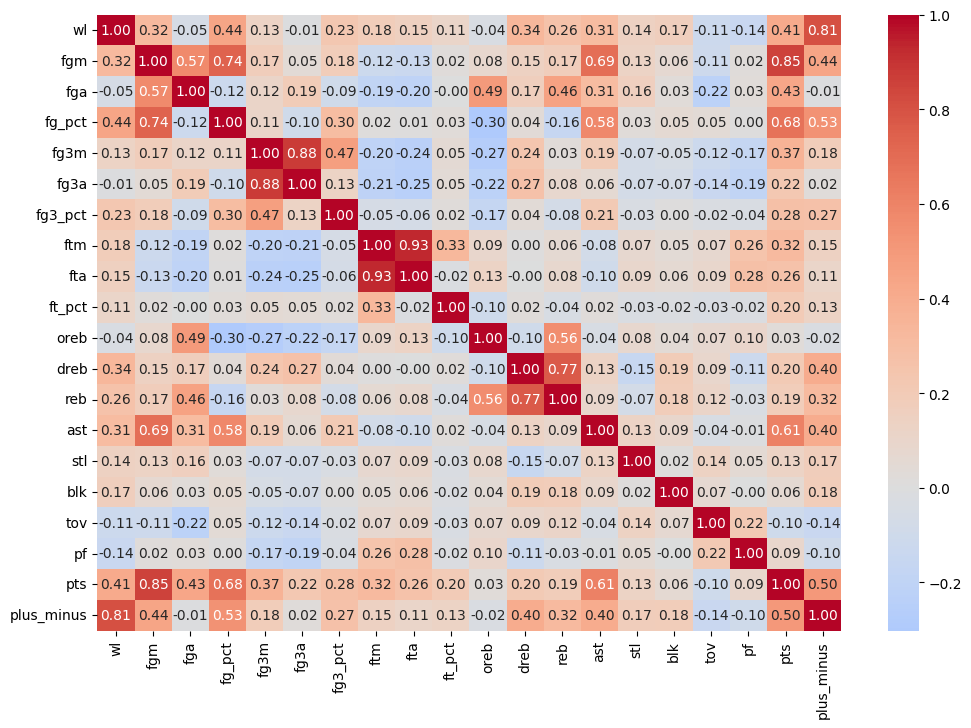

In [21]:
# Compute correlation matrix
corr_matrix = heatmap_df.corr()

# Set figure size
plt.figure(figsize=(12, 8))

# Create heatmap
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0, fmt=".2f") # center=0 makes only pos correlations red and only neg correlations blue

# Show plot
plt.show()


There is a lot of good information here.
- Most correlations are positive and weak.
- Realted stats are more correlated as you would expect. (free throws made and free throws attempted are 93% corr)
- Defensive, offensive and total rebounds all highly correlated.
- Assists and field goals made are pretty highly correlated.
- Strongest negative correlation between offensive rebounds and field goal percentage. Why might that be?
- Plus minus is 81% correlated with wins! But what does plus minus even mean? The deffinition one the internet is: plus/minus (+/-) represents how the team's point differential changes while they are on the court compared to their opponent. If thats the case then wouldn't it be expected that plus/minus would be 100% correlated with win/loss? Maybe we shouldn't include this stat when training our model later.
- The two next highest correlated stats with win/loss are points and field goal percentage.


## K-Means Clustering

First we'll create a random sample of rows to use for the elbow and silhouette method so they don't take forever to calculate.

In [22]:
# Randomly sample N rows (adjust sample size based on your needs)
sample_size = 5000  # Adjust this based on your dataset size
df_sample = final_df.sample(n=sample_size, random_state=42)

In [23]:
# Choose which columns to include in the 
columns_to_cluster = [
    'wl', 'fgm', 'fga', 'fg_pct', 'fg3m', 'fg3a',
    'fg3_pct', 'ftm', 'fta', 'ft_pct', 'oreb', 'dreb',
    'reb', 'ast', 'stl', 'blk', 'tov', 'pf', 'pts', 'plus_minus'
] # same columns as the heatmap

# Create a new dataframe to work with for the purposes of K-Means Clustering
cluster_df = df_sample[columns_to_cluster]

# Save feature names
feature_names = cluster_df.columns

# Scale the numeric features
scaler = StandardScaler()
cluster_df_scaled = scaler.fit_transform(cluster_df)


## Find the Optimal Number of Clusters (Elbow Method)

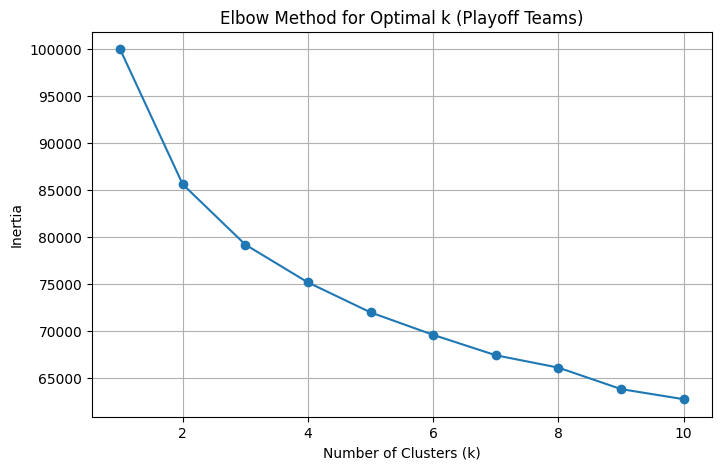

In [24]:
inertia = []

for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(cluster_df_scaled)
    inertia.append(kmeans.inertia_)

# Plot the elbow graph
plt.figure(figsize=(8,5))
plt.plot(range(1, 11), inertia, marker='o')
plt.title('Elbow Method for Optimal k (Playoff Teams)')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()

This elbow graph has a very smooth curve so its pretty hard to tell what k should be. Lets see if the silhouette method yeilds clearer results.

## Find the Optimal Number of Clusters (Silhouette Method)

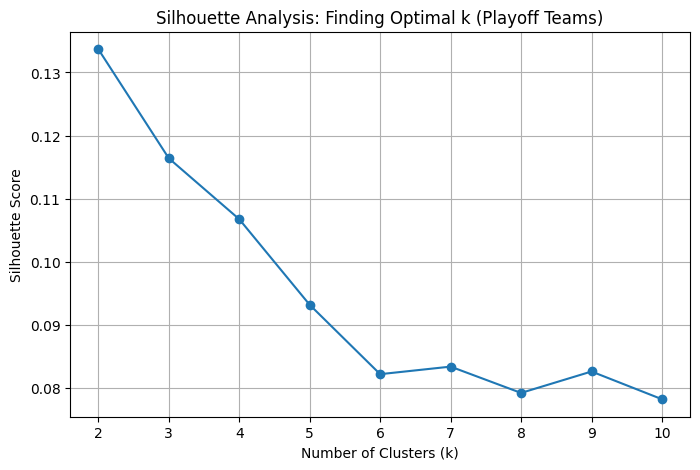

In [25]:
# Range of k values (must start at 2 because silhouette needs at least 2 clusters)
k_range = range(2, 11)

silhouette_scores = []

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(cluster_df_scaled)
    score = silhouette_score(cluster_df_scaled, labels)
    silhouette_scores.append(score)

# Plot Silhouette Scores
plt.figure(figsize=(8,5))
plt.plot(k_range, silhouette_scores, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Analysis: Finding Optimal k (Playoff Teams)')
plt.grid(True)
plt.show()

The silhouette method shows diminishing returns after just 2 clusters.

We will use k = 2 for our numnber of clusters.

## Apply K-Means Clustering

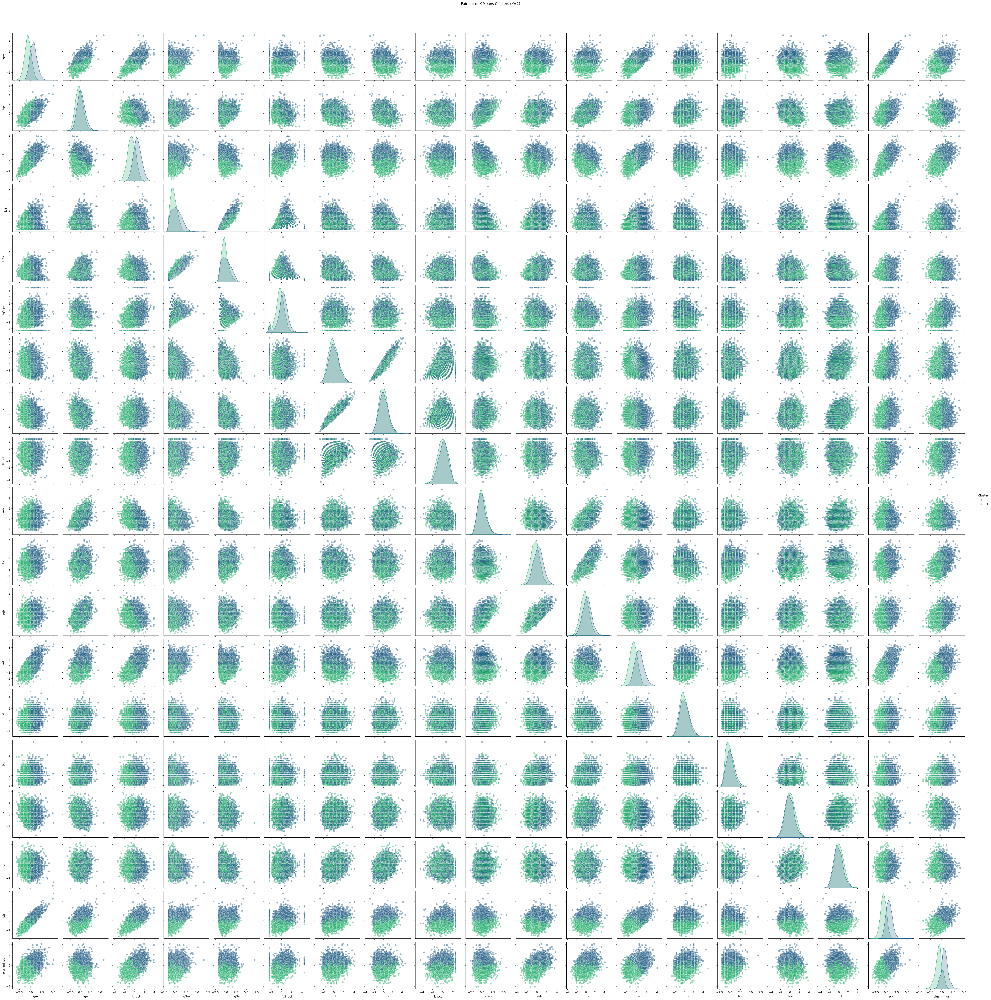

In [26]:
k = 2  # Number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
labels = kmeans.fit_predict(cluster_df_scaled)

# Convert the scaled array back to a DataFrame (so seaborn can plot column names)
cluster_df_with_labels = pd.DataFrame(cluster_df_scaled, columns=feature_names)

# Add the cluster labels from sklearn KMeans
cluster_df_with_labels['Cluster'] = labels

# Pairplot
sns.pairplot(
    cluster_df_with_labels,
    vars=['fgm', 'fga', 'fg_pct', 'fg3m', 'fg3a',
    'fg3_pct', 'ftm', 'fta', 'ft_pct', 'oreb', 'dreb',
    'reb', 'ast', 'stl', 'blk', 'tov', 'pf', 'pts', 'plus_minus'],  # all numberical features
    hue='Cluster',  # Color points by sklearn cluster labels
    diag_kind='kde',
    palette='viridis',
    plot_kws={'alpha': 0.5}
)

plt.suptitle(f'Pairplot of K-Means Clusters (K={k})', y=1.02)
plt.show()

Here we have an absolutely massive pairplot of clusters. They're so small that its hard to see which features are being compared. Lets run it again with just a few features selected so we can get a better look.

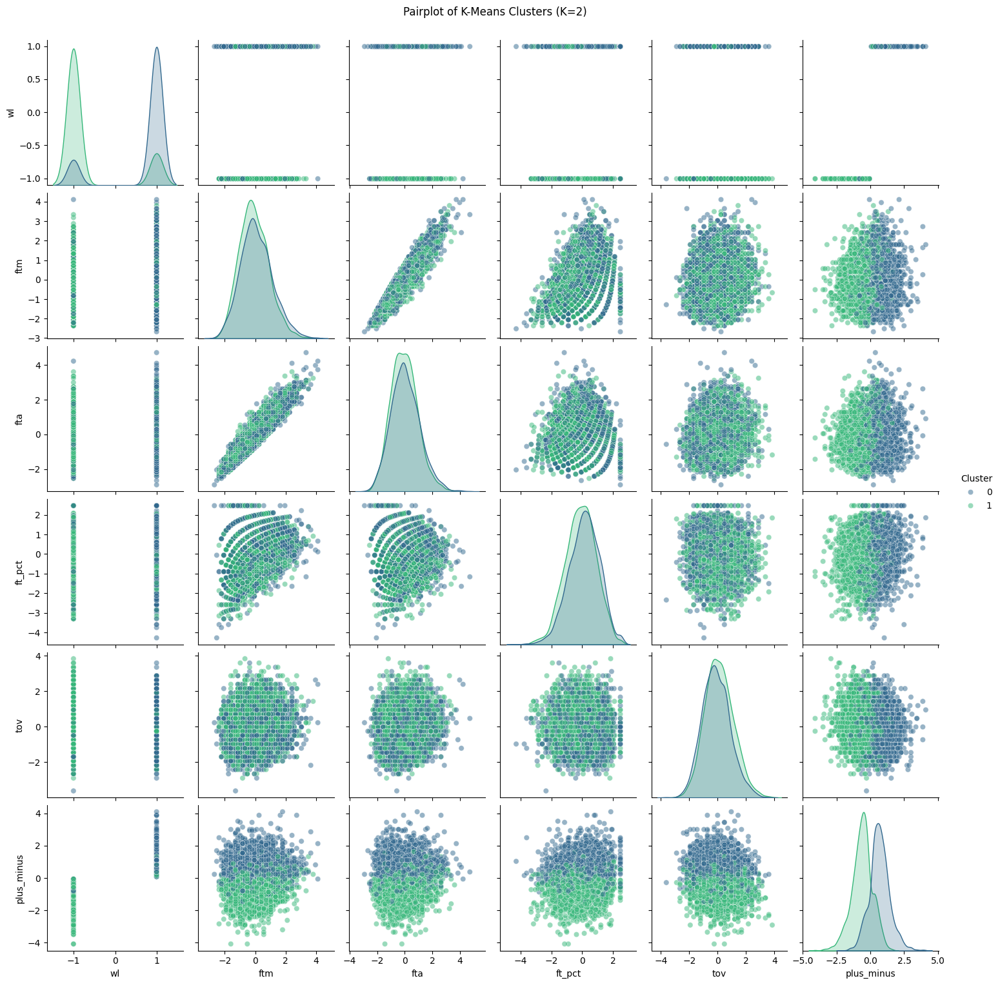

In [27]:
# Pairplot
sns.pairplot(
    cluster_df_with_labels,
    vars=['wl', 'ftm', 'fta', 'ft_pct', 'tov', 'plus_minus'],  # Pick 3-5 important stats
    hue='Cluster',  # Color points by sklearn cluster labels
    diag_kind='kde',
    palette='viridis',
    plot_kws={'alpha': 0.5}
)

plt.suptitle(f'Pairplot of K-Means Clusters (K={k})', y=1.02)
plt.show()

Thats better. But even with k = 2, there is very little if any seperation between the clusters. This likely indicates that there isn't a strong or obvious correlation between the clusters.

---

# Step 4: Predict Game Outcome Using Game Data
Since we are trying to predict a categorical target (win/loss), we should use a classification model such as logistic regression


In [28]:
# Select features and target
features = [
    'fgm', 'fga', 'fg_pct', 'fg3m', 'fg3a',
    'fg3_pct', 'ftm', 'fta', 'ft_pct', 'oreb', 'dreb',
    'reb', 'ast', 'stl', 'blk', 'tov', 'pf', 'pts', 'plus_minus'
]

X = final_df[features]
y = final_df['wl']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the logistic regression model
model = LogisticRegression(max_iter=1000, random_state=41)
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))

# Analyze feature importance
coefficients = model.coef_[0]
feature_importance = pd.DataFrame({'Feature': features, 'Coefficient': coefficients})
feature_importance = feature_importance.sort_values(by='Coefficient', ascending=False)
print(feature_importance)

Accuracy: 1.0
Confusion Matrix:
 [[9301    0]
 [   0 9233]]
Classification Report:
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      9301
         1.0       1.00      1.00      1.00      9233

    accuracy                           1.00     18534
   macro avg       1.00      1.00      1.00     18534
weighted avg       1.00      1.00      1.00     18534

       Feature  Coefficient
18  plus_minus     5.255344
0          fgm     4.057878
3         fg3m     1.991732
6          ftm     1.970834
8       ft_pct     0.191951
7          fta     0.105711
5      fg3_pct     0.101919
12         ast     0.097976
4         fg3a     0.032564
2       fg_pct     0.026275
13         stl     0.018159
1          fga     0.012851
15         tov     0.011022
10        dreb    -0.001250
9         oreb    -0.008882
11         reb    -0.010132
14         blk    -0.061467
16          pf    -0.063000
17         pts    -2.061265


Our logistic regression model can predict the winner of a game based on the selected features with 100% accuracy! That is suspiciously accurate..

The correlation coefficient measures how strongly two variables are related. In the context of logistic regression, it helps determine whether a predictor variable is associated with the probability of the outcome (e.g., win/loss).

Lets plot those correlation coefficients to get a better look at which features are having the biggest impact on the model's prediction.

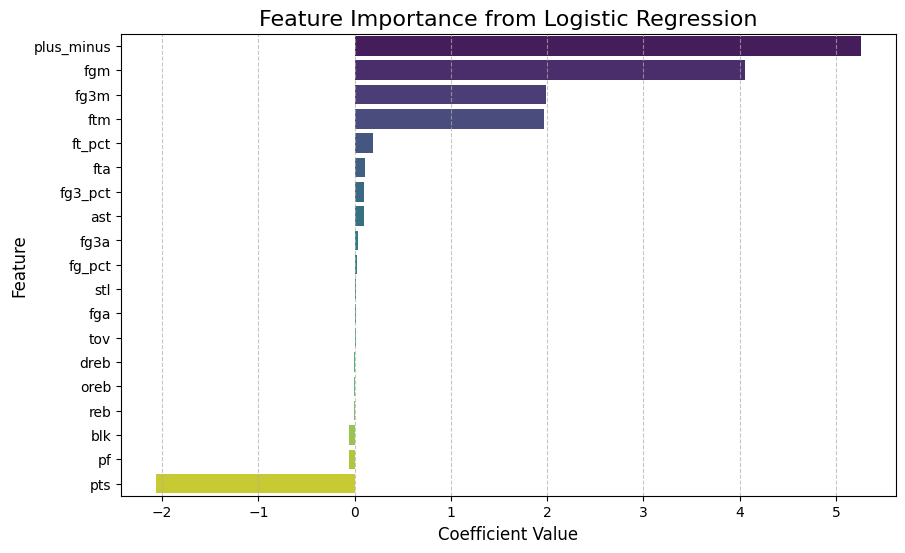

In [29]:
# Plot feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Coefficient', y='Feature', data=feature_importance, palette='viridis', hue='Feature')

plt.title('Feature Importance from Logistic Regression', fontsize=16)
plt.xlabel('Coefficient Value', fontsize=12)
plt.ylabel('Feature', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

Plus_minus, fgm, fg3m, ftm, and pts are all heavily used in the prediction compared to the rest of the stats. What would happen if we didn't use any of those points-related stats in our model?

In [30]:
# Select features and target
features = [
    'fga', 'fg_pct', 'fg3a',
    'fg3_pct', 'fta', 'ft_pct', 'oreb', 'dreb',
    'reb', 'ast', 'stl', 'blk', 'tov', 'pf'
] # Plus_minus, fgm, fg3m, ftm, and pts removed

X = final_df[features]
y = final_df['wl']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the logistic regression model
model = LogisticRegression(max_iter=1000, random_state=41)
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))

# Analyze feature importance
coefficients = model.coef_[0]
feature_importance = pd.DataFrame({'Feature': features, 'Coefficient': coefficients})
feature_importance = feature_importance.sort_values(by='Coefficient', ascending=False)
print(feature_importance)

Accuracy: 0.8417502967519154
Confusion Matrix:
 [[7864 1437]
 [1496 7737]]
Classification Report:
               precision    recall  f1-score   support

         0.0       0.84      0.85      0.84      9301
         1.0       0.84      0.84      0.84      9233

    accuracy                           0.84     18534
   macro avg       0.84      0.84      0.84     18534
weighted avg       0.84      0.84      0.84     18534

    Feature  Coefficient
1    fg_pct    27.374584
5    ft_pct     4.538816
3   fg3_pct     2.799947
10      stl     0.348232
8       reb     0.207538
7      dreb     0.112574
11      blk     0.103085
6      oreb     0.094964
9       ast     0.062701
4       fta     0.036181
2      fg3a     0.003879
13       pf    -0.061026
0       fga    -0.165169
12      tov    -0.287553


Now the model is only 84% accurate and all of the shot percentage stats are the beggest predictors.

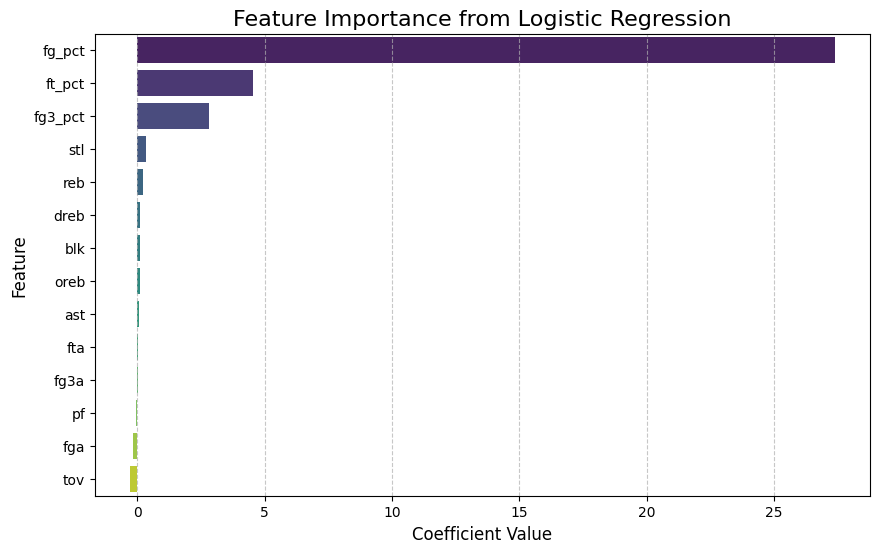

In [31]:
# Plot feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Coefficient', y='Feature', data=feature_importance, palette='viridis', hue='Feature')

plt.title('Feature Importance from Logistic Regression', fontsize=16)
plt.xlabel('Coefficient Value', fontsize=12)
plt.ylabel('Feature', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

Lets try removing those ones too and see what happens.

In [32]:
# Select features and target
features = [
    'fga','fg3a','fta', 'oreb', 'dreb',
    'reb', 'ast', 'stl', 'blk', 'tov', 'pf'
] # Plus_minus, fgm, fg3m, ftm, and pts removed

X = final_df[features]
y = final_df['wl']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the logistic regression model
model = LogisticRegression(max_iter=1000, random_state=41)
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))

# Analyze feature importance
coefficients = model.coef_[0]
feature_importance = pd.DataFrame({'Feature': features, 'Coefficient': coefficients})
feature_importance = feature_importance.sort_values(by='Coefficient', ascending=False)
print(feature_importance)

Accuracy: 0.78051149239236
Confusion Matrix:
 [[7301 2000]
 [2068 7165]]
Classification Report:
               precision    recall  f1-score   support

         0.0       0.78      0.78      0.78      9301
         1.0       0.78      0.78      0.78      9233

    accuracy                           0.78     18534
   macro avg       0.78      0.78      0.78     18534
weighted avg       0.78      0.78      0.78     18534

   Feature  Coefficient
7      stl     0.260135
6      ast     0.209181
5      reb     0.135780
4     dreb     0.114965
8      blk     0.080699
2      fta     0.035258
3     oreb     0.020814
1     fg3a    -0.010770
10      pf    -0.053940
0      fga    -0.158496
9      tov    -0.219084


Now our model is still 78% accurate but none of the stats are over influencing the results.

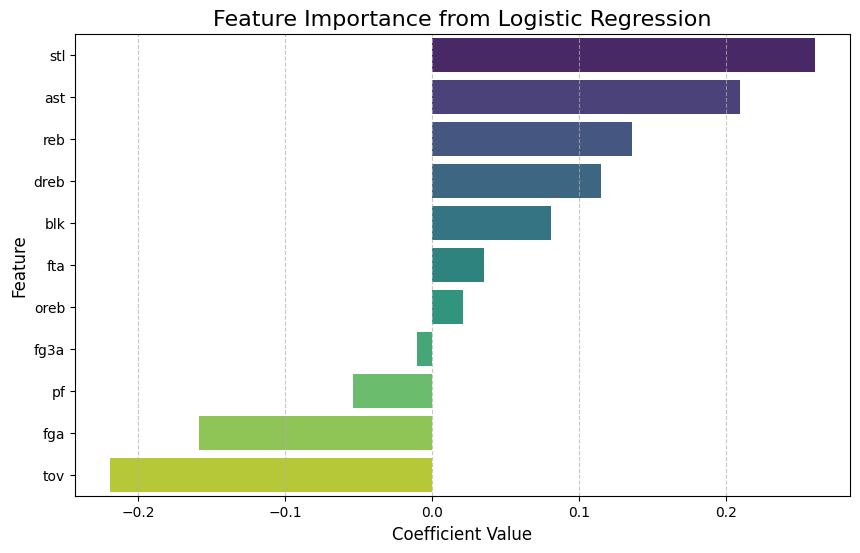

In [33]:
# Plot feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Coefficient', y='Feature', data=feature_importance, palette='viridis', hue='Feature')

plt.title('Feature Importance from Logistic Regression', fontsize=16)
plt.xlabel('Coefficient Value', fontsize=12)
plt.ylabel('Feature', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

Let's try to interpret the results:
After the more influential point stats...
- Steals, assists, and rebounds seem to have the biggest positive impact on winning the game.
- Turnovers, and fouls have a negative impact on winning the game.

What can we learn from the free throw avg, three point avg, and field goal avg stats? Maybe those ones shouldn't be included in the model either.